In [1]:
import pandas as pd
import re
import string
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx

In [15]:
network_analysis = pd.read_csv(r"data_all.csv")

In [16]:
network_analysis.head()
network_analysis['responding'] = network_analysis['responding'].apply(str)

In [17]:
def clean_data(text):
    # Mencari @username menggunakan ekspresi reguler
    usernames = re.findall(r'@([a-zA-Z0-9_]+)', text)
    
    # Menggabungkan @username menjadi satu string
    cleaned_text = ' '.join(usernames)
    
    return cleaned_text

In [18]:
network_analysis['target'] = network_analysis['responding'].apply(clean_data)

In [19]:
network_analysis

,username,handle,postDate,responding,retweets,likes,target
0,#TeruslahBergerak,@rezasilalahi,2023-09-08T14:59:33.000Z,Replying to \n@akbarfaizal68\n and \n@nagara_inst,NaN,NaN,akbarfaizal68 nagara_inst
1,solichin jamaludin,@wakcis,2023-09-08T14:59:08.000Z,"Anies Baswedan bilang, pembangunan tak perlu o...",NaN,NaN,
2,Andi Manik,@Andi_Manik,2023-09-08T14:58:49.000Z,Replying to \n@sutanmangara,NaN,NaN,sutanmangara
3,Zulfikar Arma x,@ArmaZulfikar,2023-09-08T14:58:36.000Z,Replying to \n@sutanmangara,NaN,NaN,sutanmangara
4,rakyatjelita.com,@rakyatjelitacom,2023-09-08T14:58:24.000Z,Replying to \n@seruanhl\n @ch_chotimah2\n and ...,NaN,NaN,seruanhl ch_chotimah2
...,...,...,...,...,...,...,...
8231,Qwerty,@xaquily,2024-03-24T09:57:23.000Z,Membalas \n@G0P4NK_G0P4NG_7\n @aniesbaswedan\n...,NaN,NaN,G0P4NK_G0P4NG_7 aniesbaswedan
8232,gibran basis bratson,@orangsurga,2024-03-24T09:57:23.000Z,Membalas \n@boraheamri\n @expebt\n dan 4 lainnya,NaN,NaN,boraheamri expebt
8233,Gibran,@brangbrn,2024-03-24T09:57:19.000Z,Membalas \n@Ribka_JKT48,NaN,NaN,Ribka_JKT48
8234,MenolakMencret,@arwindras,2024-03-24T09:56:11.000Z,Membalas \n@olym_jae\n @littleg83443669\n dan...,NaN,NaN,olym_jae littleg83443669


In [20]:
network_analysis.drop(['username', 'postDate','responding','retweets','likes'], axis=1, inplace=True)

In [21]:
network_analysis

,handle,target
0,@rezasilalahi,akbarfaizal68 nagara_inst
1,@wakcis,
2,@Andi_Manik,sutanmangara
3,@ArmaZulfikar,sutanmangara
4,@rakyatjelitacom,seruanhl ch_chotimah2
...,...,...
8231,@xaquily,G0P4NK_G0P4NG_7 aniesbaswedan
8232,@orangsurga,boraheamri expebt
8233,@brangbrn,Ribka_JKT48
8234,@arwindras,olym_jae littleg83443669


In [11]:
network_analysis.to_csv("cleaned_output_2.csv", index=False)


In [22]:
a = pd.read_csv('cleaned_output_2.csv')

In [23]:
a

,handle,target
0,@rezasilalahi,akbarfaizal68 nagara_inst
1,@wakcis,NaN
2,@Andi_Manik,sutanmangara
3,@ArmaZulfikar,sutanmangara
4,@rakyatjelitacom,seruanhl ch_chotimah2
...,...,...
8231,@xaquily,G0P4NK_G0P4NG_7 aniesbaswedan
8232,@orangsurga,boraheamri expebt
8233,@brangbrn,Ribka_JKT48
8234,@arwindras,olym_jae littleg83443669


In [24]:
a.dropna(inplace=True)

In [27]:
a.to_csv("cleaned_output_2.csv", index=False)

In [28]:
# Membaca file CSV yang berisi kolom "source" dan "target"
df = pd.read_csv(r"D:\Skripsi\archive\Skripsi\Ipynb\cleaned_output_2.csv")

# Membuat daftar kosong
new_data = []
for index, row in df.iterrows():
    # Memisahkan entri dalam kolom "source" dan "target"
    sources = row["handle"].split(',')
    targets = row["target"].split()
    
    # Menambahkan dua baris ke daftar baru dengan nama yang sesuai
    for source in sources:
        for target in targets:
            new_data.append({"source": source.strip(), "target": target.strip()})

# Membuat DataFrame baru dari hasil pemisahan
new_df = pd.DataFrame(new_data)

# Menyimpan hasil pemisahan ke dalam file CSV
new_df.to_csv("split_data.csv", index=False)

In [29]:
new_df["target"] = "@" + new_df["target"]

# Menyimpan hasil perubahan ke dalam file CSV
new_df.to_csv("modified_data.csv", index=False)

In [30]:
new_df

,source,target
0,@rezasilalahi,@akbarfaizal68
1,@rezasilalahi,@nagara_inst
2,@Andi_Manik,@sutanmangara
3,@ArmaZulfikar,@sutanmangara
4,@rakyatjelitacom,@seruanhl
...,...,...
9021,@orangsurga,@expebt
9022,@brangbrn,@Ribka_JKT48
9023,@arwindras,@olym_jae
9024,@arwindras,@littleg83443669


In [53]:
sliced_df = new_df.head(500)
print(sliced_df.head(500))
sliced_df.to_csv("modified_data_2.csv", index=False)

               source          target
0       @rezasilalahi  @akbarfaizal68
1       @rezasilalahi    @nagara_inst
2         @Andi_Manik   @sutanmangara
3       @ArmaZulfikar   @sutanmangara
4    @rakyatjelitacom       @seruanhl
..                ...             ...
495      @DendyStohan      @cakimiNOW
496      @DendyStohan        @DPP_PKB
497      @DendyStohan   @anisbaswedan
498         @heni_wee     @cakiminNOW
499         @heni_wee        @DPP_PKB

[500 rows x 2 columns]


In [52]:
G = nx.DiGraph()
nodes = set(sliced_df["source"]).union(sliced_df["target"])
G.add_nodes_from(nodes)

# Tambahkan sambungan (edges) dari kolom "source" dan "target"
edges = list(zip(sliced_df["source"], sliced_df["target"]))
G.add_edges_from(edges)

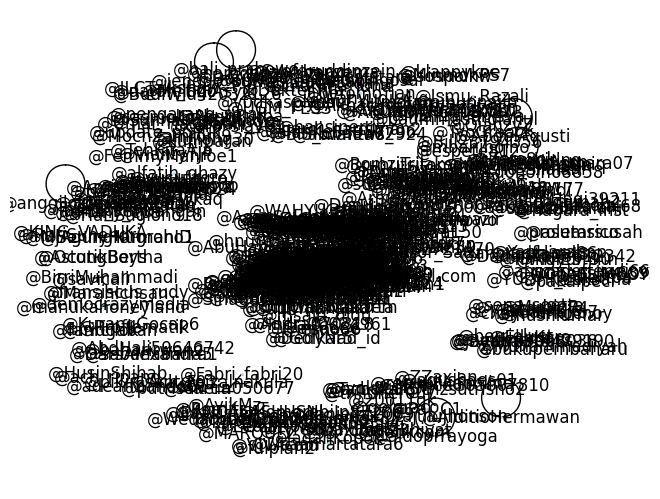

In [66]:
nx.draw(G, with_labels=True, node_color='lightblue', node_size=1, font_size=12)
plt.show()

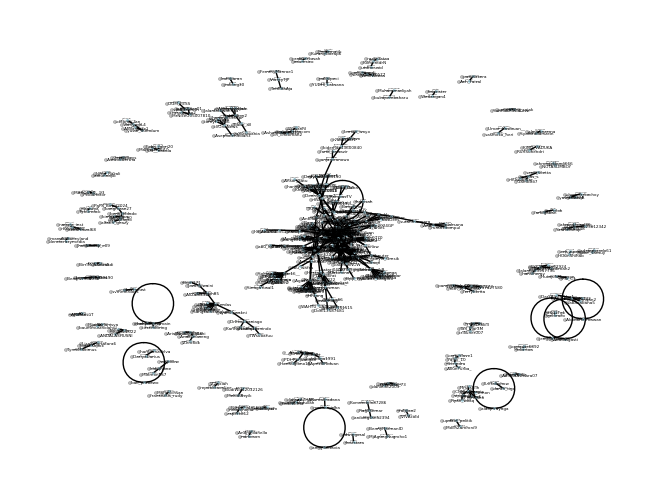

In [70]:
degree_centrality = nx.degree_centrality(G)

# Visualisasi grafik
pos = nx.spring_layout(G)  # Layout untuk visualisasi
nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=1, font_size=3)

# Tambahkan degree centrality sebagai label simpul
labels = {node: f"{node}\nDegree Centrality: {centrality:.2f}" for node, centrality in degree_centrality.items()}
nx.draw_networkx_labels(G, pos, labels, font_size=1, verticalalignment="bottom")

plt.show()





In [63]:
from matplotlib.pyplot import figure, text

# Baca data dari file CSV
df = pd.read_csv(r"modified_data_2.csv")

# Inisialisasi grafik
G = nx.Graph()

# Tambahkan simpul (nodes) dari kolom "source" dan "target"
nodes = set(df["source"]).union(df["target"])
G.add_nodes_from(nodes)

# Tambahkan sambungan (edges) dari kolom "source" dan "target"
edges = list(zip(df["source"], df["target"]))
G.add_edges_from(edges)

# Menghitung degree centrality
degree_centrality = nx.degree_centrality(G)

# Visualisasi grafik dengan Spring layout
pos = nx.spring_layout(G, iterations=9000, seed=1721)  # Sesuaikan nilai k sesuai kebutuhan Anda

# Atur ukuran node berdasarkan degree centrality
node_size = [2 * degree_centrality[node] for node in G.nodes()]

# Membuat objek gambar dengan ukuran yang lebih besar
plt.figure(figsize=(150, 90))

# Menggambar simpul dan sambungan
nx.draw(G, pos, node_color='lightblue', node_size=node_size, font_size=12)

# Menambahkan degree centrality sebagai label simpul
nx.draw_networkx_labels(G, pos, font_size=18, verticalalignment="bottom")

# Menampilkan gambar
plt.show()



In [62]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np

# Load the data
df = pd.read_csv('modified_data_2.csv')

# Initialize the graph
G = nx.Graph()

# Add nodes from 'source' and 'target' columns
nodes = set(df['source']).union(df['target'])
G.add_nodes_from(nodes)

# Add edges from 'source' and 'target' columns
edges = list(zip(df['source'], df['target']))
G.add_edges_from(edges)

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G)

# Create a Spring layout for the graph
pos = nx.spring_layout(G, iterations=1000, seed=1721)

# Set node size based on degree centrality
node_size = [2 * degree_centrality[node] for node in G.nodes()]

# Create a figure with a larger size for better visibility
plt.figure(figsize=(150, 90))

# Draw nodes and edges
nx.draw(G, pos, node_color='lightblue', node_size=node_size, font_size=12, with_labels=False)

# Compute centroids of each cluster
clusters = nx.connected_components(G)
centroids = []
for cluster in clusters:
    cluster_positions = np.array([pos[node] for node in cluster])
    centroid = np.mean(cluster_positions, axis=0)
    centroids.append(centroid)

# Find labels closest to centroids
labels = nx.draw_networkx_labels(G, pos, font_size=18, verticalalignment='bottom', labels={})
for centroid in centroids:
    if labels:
        closest_label = min(labels.keys(), key=lambda x: np.linalg.norm(np.array(pos[x]) - centroid))
        labels[closest_label] = G.nodes[closest_label]['label']

# Display the plot
plt.show()


Unique sources: 242
Unique targets: 199
[0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.007009345794392522, 0.004672897196261682, 0.004672897196261682, 0.004672897196261682, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.10046728971962617, 0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.014018691588785045, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.007009345794392522, 0.002336448598130841, 0.016355140186915886, 0.007009345794392522, 0.002336448598130841, 0.007009345794392522, 0.004672897196261682, 0.002336448598130841, 0.007009345794392522, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.004672897196261682, 0.007009345794392522, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.016355140186915886, 0.004672897196261682, 0.004672897196261682, 0.002336448598

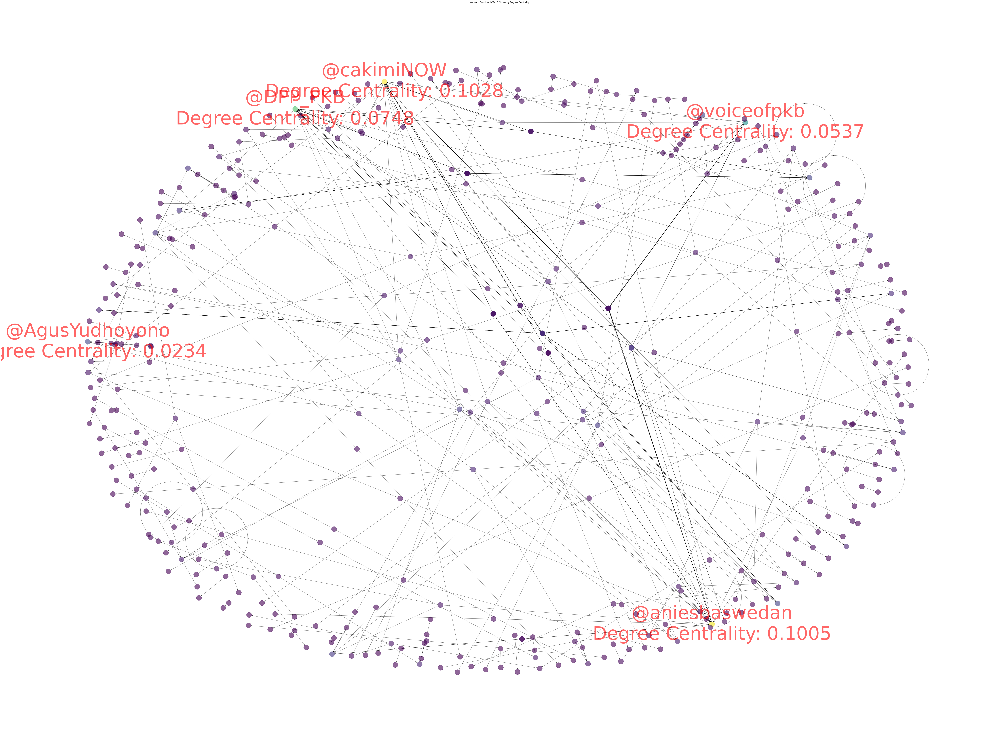

In [157]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the data
data = pd.read_csv('modified_data_2.csv')

# Basic overview
unique_sources = data['source'].nunique()
unique_targets = data['target'].nunique()

print(f'Unique sources: {unique_sources}')
print(f'Unique targets: {unique_targets}')

# Create directed graph
G = nx.from_pandas_edgelist(data, source='source', target='target', create_using=nx.DiGraph)

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G)

# Get top 5 nodes by degree centrality
top_5_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]

# Add labels to the top 5 nodes
labels = {node: f'{node}\nDegree Centrality: {centrality:.4f}' for node, centrality in top_5_degree}

# Draw the graph with labels
plt.figure(figsize=(75, 55))
pos = nx.spring_layout(G, scale=10,iterations=100)
node_colors = list(degree_centrality.values())
print(list(degree_centrality.values()))
cmap = plt.cm.viridis  # Choose a colormap (e.g., viridis)
vmin = min(node_colors)
vmax = max(node_colors)

nx.draw(G, pos, with_labels=True, labels=labels, node_size=800, node_color=node_colors, 
        font_color='red', font_size=100, alpha=0.6, cmap=cmap, vmin=vmin, vmax=vmax)
plt.title('Network Graph with Top 5 Nodes by Degree Centrality')
plt.show()


Unique sources: 242
Unique targets: 199
[0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.007009345794392522, 0.004672897196261682, 0.004672897196261682, 0.004672897196261682, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.10046728971962617, 0.004672897196261682, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.014018691588785045, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.007009345794392522, 0.002336448598130841, 0.016355140186915886, 0.007009345794392522, 0.002336448598130841, 0.007009345794392522, 0.004672897196261682, 0.002336448598130841, 0.007009345794392522, 0.002336448598130841, 0.002336448598130841, 0.002336448598130841, 0.004672897196261682, 0.007009345794392522, 0.002336448598130841, 0.004672897196261682, 0.002336448598130841, 0.016355140186915886, 0.004672897196261682, 0.004672897196261682, 0.002336448598

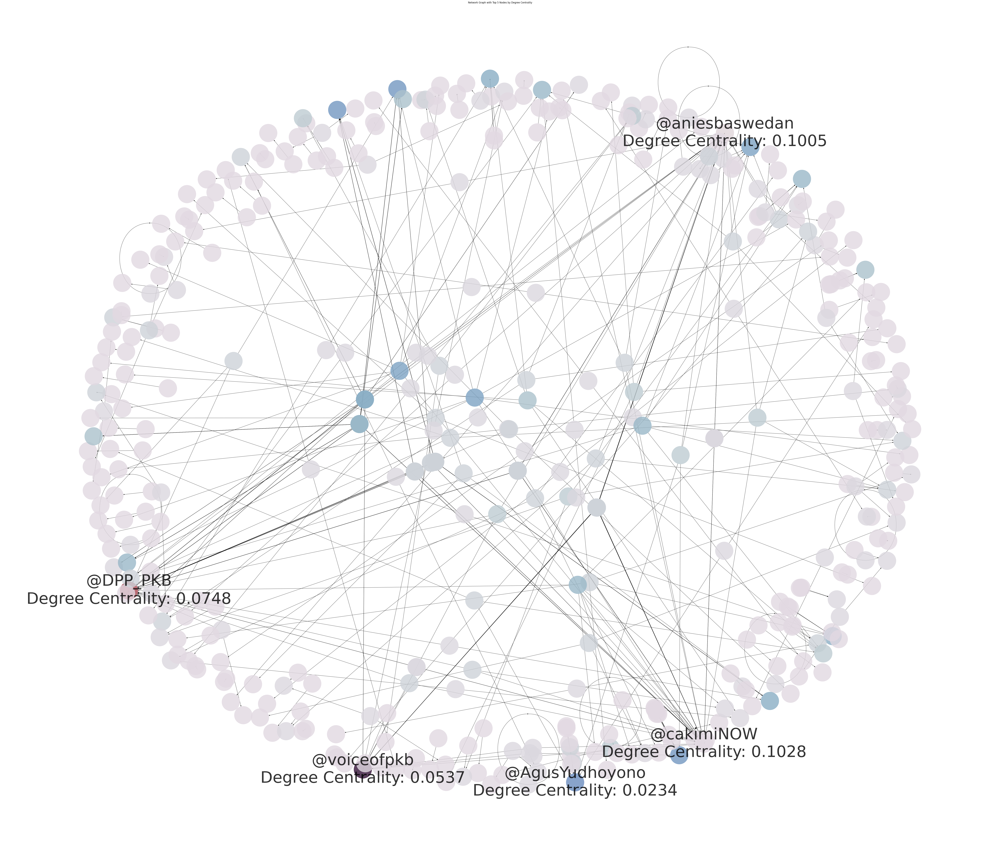

In [176]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the data
data = pd.read_csv('modified_data_2.csv')

# Basic overview
unique_sources = data['source'].nunique()
unique_targets = data['target'].nunique()

print(f'Unique sources: {unique_sources}')
print(f'Unique targets: {unique_targets}')

# Create directed graph
G = nx.from_pandas_edgelist(data, source='source', target='target', create_using=nx.DiGraph)

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G)

# Get top 5 nodes by degree centrality
top_5_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]

# Add labels to the top 5 nodes
labels = {node: f'{node}\nDegree Centrality: {centrality:.4f}' for node, centrality in top_5_degree}

# Draw the graph with labels
plt.figure(figsize=(70, 60))
pos = nx.spring_layout(G, scale=0.1,iterations=100)
node_colors = list(degree_centrality.values())
print(list(degree_centrality.values()))
cmap = plt.cm.twilight  # Choose a colormap (e.g., viridis)
vmin = min(node_colors)
vmax = max(node_colors)

nx.draw(G, pos, with_labels=True, labels=labels, node_size=8200, node_color=node_colors, 
        font_color='black', font_size=80, alpha=0.8, cmap=cmap, vmin=vmin, vmax=vmax)
plt.title('Network Graph with Top 5 Nodes by Degree Centrality')
plt.show()


In [171]:
from matplotlib import colormaps
list(colormaps)

['magma',
 'inferno',
 'plasma',
 'viridis',
 'cividis',
 'twilight',
 'twilight_shifted',
 'turbo',
 'Blues',
 'BrBG',
 'BuGn',
 'BuPu',
 'CMRmap',
 'GnBu',
 'Greens',
 'Greys',
 'OrRd',
 'Oranges',
 'PRGn',
 'PiYG',
 'PuBu',
 'PuBuGn',
 'PuOr',
 'PuRd',
 'Purples',
 'RdBu',
 'RdGy',
 'RdPu',
 'RdYlBu',
 'RdYlGn',
 'Reds',
 'Spectral',
 'Wistia',
 'YlGn',
 'YlGnBu',
 'YlOrBr',
 'YlOrRd',
 'afmhot',
 'autumn',
 'binary',
 'bone',
 'brg',
 'bwr',
 'cool',
 'coolwarm',
 'copper',
 'cubehelix',
 'flag',
 'gist_earth',
 'gist_gray',
 'gist_heat',
 'gist_ncar',
 'gist_rainbow',
 'gist_stern',
 'gist_yarg',
 'gnuplot',
 'gnuplot2',
 'gray',
 'hot',
 'hsv',
 'jet',
 'nipy_spectral',
 'ocean',
 'pink',
 'prism',
 'rainbow',
 'seismic',
 'spring',
 'summer',
 'terrain',
 'winter',
 'Accent',
 'Dark2',
 'Paired',
 'Pastel1',
 'Pastel2',
 'Set1',
 'Set2',
 'Set3',
 'tab10',
 'tab20',
 'tab20b',
 'tab20c',
 'grey',
 'gist_grey',
 'gist_yerg',
 'Grays',
 'magma_r',
 'inferno_r',
 'plasma_r',
 'viri

Unique sources: 242
Unique targets: 199


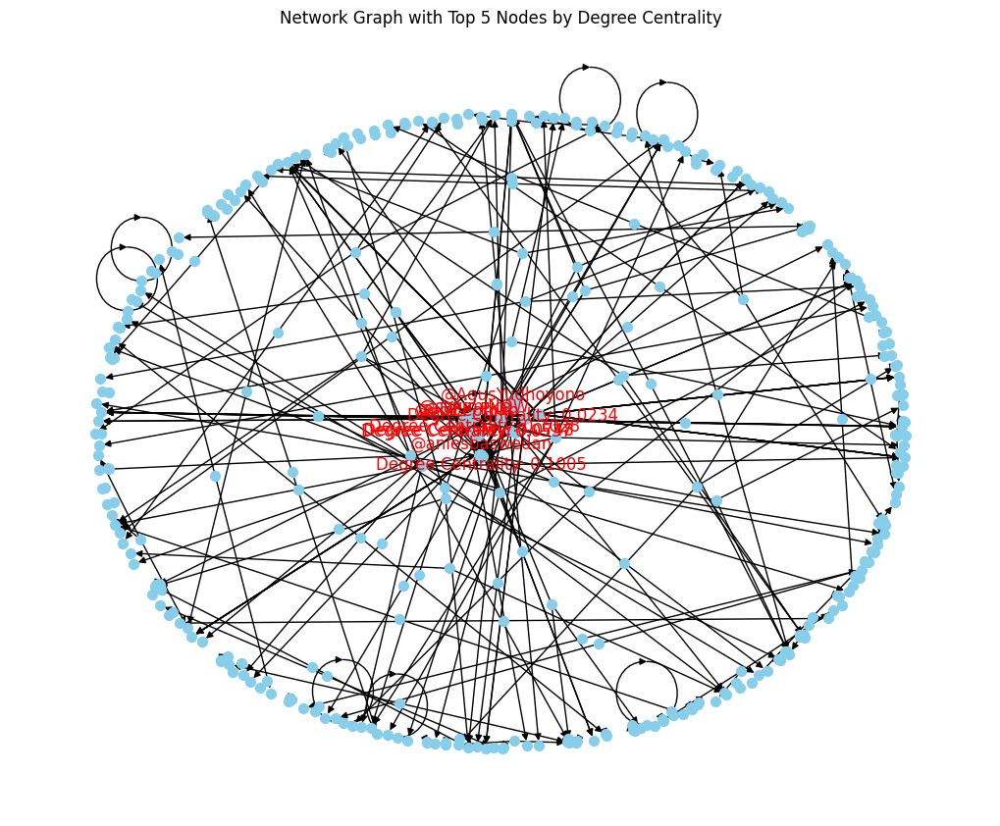

In [151]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt

# Load the data
data = pd.read_csv('modified_data_2.csv')

# Basic overview
unique_sources = data['source'].nunique()
unique_targets = data['target'].nunique()

print(f'Unique sources: {unique_sources}')
print(f'Unique targets: {unique_targets}')

# Create directed graph
G = nx.from_pandas_edgelist(data, source='source', target='target', create_using=nx.DiGraph)

# Calculate degree centrality
degree_centrality = nx.degree_centrality(G)

# Get top 5 nodes by degree centrality
top_5_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]

# Add labels to the top 5 nodes
labels = {node: f'{node}\nDegree Centrality: {centrality:.4f}' for node, centrality in top_5_degree}

# Draw the graph
plt.figure(figsize=(10, 8))

# Positioning the top 5 nodes in the middle
pos = nx.spring_layout(G, scale=0.5)  # Adjust scale parameter for tighter layout

# Scatter the top 5 nodes in the middle
top_nodes = [node for node, _ in top_5_degree]
pos_top = nx.spring_layout(G, pos=pos, fixed=top_nodes, iterations=100)

# Draw the graph with labels
nx.draw(G, pos_top, with_labels=True, labels=labels, node_size=50, node_color='skyblue', font_color='red', font_size=12)
plt.title('Network Graph with Top 5 Nodes by Degree Centrality')
plt.show()



In [147]:
import scipy.sparse


G = nx.Graph()
G.add_edges_from([(0, 1), (1, 2), (2, 3), (3, 4)])
sparse_matrix = nx.to_scipy_sparse_array(G)
print(sparse_matrix)

  (0, 1)	1
  (1, 0)	1
  (1, 2)	1
  (2, 1)	1
  (2, 3)	1
  (3, 2)	1
  (3, 4)	1
  (4, 3)	1


In [35]:
nodes

{'@teddy_syah328',
 '@qmunkkk',
 '@AndriMilanello',
 '@Zly_aja',
 '@dayana47631052',
 '@detikcom',
 '@Bhefals',
 '@ariefbudiawan7',
 '@PdgSkm',
 '@AraGiwangkara',
 '@Dmxlrd',
 '@HarisCountrys',
 '@siyasah_aswaja',
 '@Cekeklengek',
 '@men_thank6939',
 '@lnfbbbb',
 '@Pepatah_dr_Chin',
 '@IwanIwanely72',
 '@dubidubi_damn',
 '@anieskurly',
 'Hendra@@',
 '@MboWar4',
 '@PartaiDemokrat',
 '@gibran_gen',
 '@katardn',
 '@Indomitable1979',
 '@SintaAzkiia',
 '@alfiarnimakhtaf',
 '@Kakaqwertyu',
 '@FirdausNainggo9',
 '@Werkudoro2024',
 '@BobElTor',
 '@Robinbinbin1',
 '@hmad Y@min',
 '@toomattchu',
 '@howtodresvvell',
 '@ombotobo',
 '@Dulure_Gibran',
 '@PediaHoror',
 '@katz_nadaHQ',
 '@larkapul',
 '@kamalaj82',
 '@Aditia00024961',
 '@kkneeldown',
 '@rekombukubybayu',
 '@PDemokrat',
 '@holhar60',
 '@karaeng_lipank',
 '@Deckyalvares',
 '@DinaKusmayanti9',
 '@pypytimut',
 '@MjAgungNugroho1',
 '@Anwar060373',
 '@BahasaHati6',
 '@wakcis',
 '@UtomoPrasojo',
 '@BancadaCyan',
 '@julianike31',
 '@Siahaan040

In [36]:
edges

[('@rezasilalahi', '@akbarfaizal68'),
 ('@rezasilalahi', '@nagara_inst'),
 ('@Andi_Manik', '@sutanmangara'),
 ('@ArmaZulfikar', '@sutanmangara'),
 ('@rakyatjelitacom', '@seruanhl'),
 ('@rakyatjelitacom', '@ch_chotimah2'),
 ('@ahmadeffendi666', '@NOTASLIMBOY'),
 ('@ariiiiiss', '@BangPino__'),
 ('@ariiiiiss', '@aniesbaswedan'),
 ('@Agai569357175', '@kampium2024GP'),
 ('@Agai569357175', '@aniesbaswedan'),
 ('@SunnahRasulLove', '@pengarang_sajak'),
 ('@Aditia00024961', '@msaid_didu'),
 ('@Ach_Faizal', '@putrisakera'),
 ('@KarinaNadila18', '@DrEvaChaniago'),
 ('@mas_alku', '@Dennysiregar7'),
 ('@kideman43600840', '@ivanazhar1'),
 ('@kideman43600840', '@ganjarpranowo'),
 ('@kideman43600840', '@prabowo'),
 ('@ferryberita', '@Yom_N_Friends'),
 ('@dhany_e09', '@Jhonkosmik'),
 ('@AkunPurba_', '@Gerindra'),
 ('@BangJiih85', '@AliZain435h'),
 ('@BangJiih85', '@JazuliJuwaini'),
 ('@SangkalaSangka6', '@OposisiCerdas'),
 ('@PapaWinarto', '@Tjel0up'),
 ('@PapaWinarto', '@aniesbaswedan'),
 ('@ariiiiiss

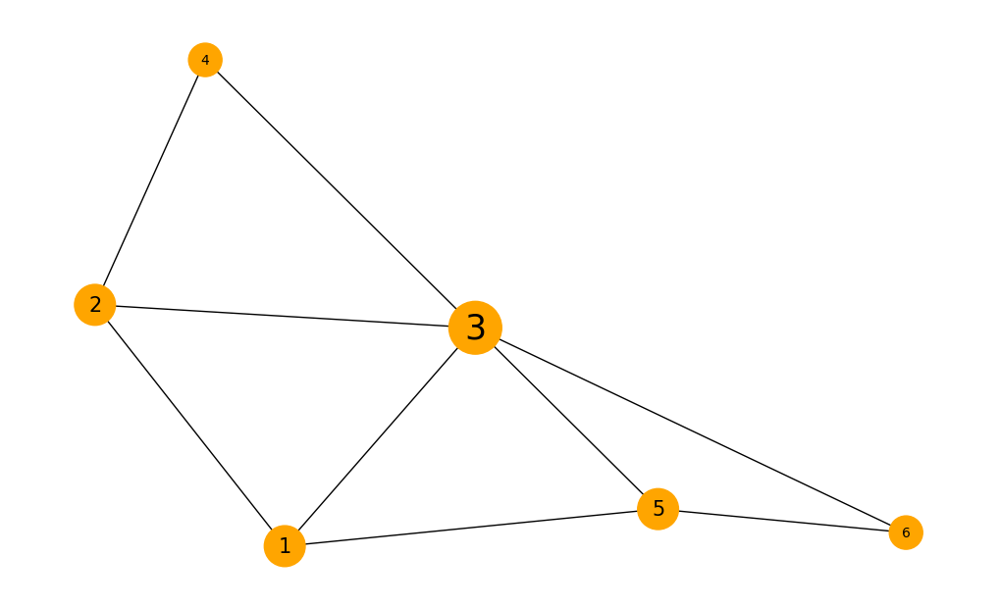

In [75]:
from matplotlib.pyplot import figure, text
import networkx as nx

G = nx.Graph()
e = [(1,2),(1,5),(2,3),(3,6),(5,6),(4,2),(4,3),(3,5),(1,3)]
G.add_edges_from(e)
pos = nx.spring_layout(G)

# Set a default size for nodes without a degree
default_node_size = 3

figure(figsize=(10,6))
d = dict(G.degree)
nx.draw(G, pos=pos, node_color='orange', 
        with_labels=False, 
        node_size=[d.get(k, default_node_size)*300 for k in G.nodes()])
for node, (x, y) in pos.items():
    text(x, y, node, fontsize=d.get(node, default_node_size)*5, ha='center', va='center')



In [ ]:
e

[('apple', '@se'),
 ('dua', 'apple'),
 ('apple', 'tiga'),
 ('tujuh', 'apple'),
 ('a', 'b'),
 ('apple', 'c'),
 ('b', 'd'),
 ('apple', 'b'),
 ('tes', '@se|')]

In [ ]:
edges

[('@KawalPemilu_org', '@Tati_versteeg72'),
 ('@KawalPemilu_org', '@faekri9449'),
 ('@KawalPemilu_org', '@ainunnajib'),
 ('@KawalPemilu_org', '@Eni2345'),
 ('@KawalPemilu_org', '@Andi_Rubby'),
 ('@KawalPemilu_org', '@KPU_ID'),
 ('@KawalPemilu_org', '@Eni2345'),
 ('@KawalPemilu_org', '@Andi_Rubby'),
 ('@KawalPemilu_org', '@KPU_ID'),
 ('@KawalPemilu_org', '@Tati_versteeg72'),
 ('@KawalPemilu_org', '@faekri9449'),
 ('@KawalPemilu_org', '@ainunnajib'),
 ('@KawalPemilu_org', '@Andi_Rubby'),
 ('@KawalPemilu_org', '@adjin_'),
 ('@KawalPemilu_org', '@Syawalianto'),
 ('@KawalPemilu_org', '@ainunnajib'),
 ('@KawalPemilu_org', '@faekri9449'),
 ('@KawalPemilu_org', '@ainunnajib'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', '@KawalPemilu_org'),
 ('@KawalPemilu_org', 